# Perform EDA on dataset
## Brief intro
The dataset that I will be working with consists of 200 counties across the US. The
target of interest is predicitng the average aqi levels of PM10 pollutant for a county.
3 datasets are observed for years 2017-2019. Features of dataset will consist of aqi levels, demographics, education-attainment,
income, unemployment, employment, poverty, and vehicle attributes.
## goal: Explore the data relationships of all features and understand how features compare to response variable
* Much of data profiles is covered in Exploratory_Analysis_1.ipynb file, this file will go over other areas of EDA

### Import Packages

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import sys
import os
import matplotlib.pyplot as plt
import klib
import plotly.figure_factory as ff
from IPython.core.display import display
from scipy import stats

# pd.set_option('display.max_columns', None)
# pd.reset_option('max_rows')
#np.set_printoptions(threshold=sys.maxsize)

plt.style.use('dark_background')
plt.rcParams.update({"grid.linewidth":0.5, "grid.alpha":0.5})
sns.set(style='ticks', context='talk')

In [2]:
# define useful function to create scatterplots of target feature against desired columns
def scatterplots(df, target, columns, ncol=None, figsize=(20, 25)):
    if ncol is None:
        ncol = len(columns)
    nrow = int(np.ceil(len(columns) / ncol))
    fig, axes = plt.subplots(nrow, ncol, figsize=figsize, squeeze=False)
    fig.subplots_adjust(wspace=0.7, hspace=0.7)
    for i, col in enumerate(columns):
        # ax = axes.flatten()[i]
        # ax.scatter(x = col, y = target, data=df, alpha=0.5)
        sns.regplot(ax=axes.flatten()[i], x=col, y=target, data=df, scatter_kws={'alpha':0.5})
        # ax.set(xlabel=col, ylabel=target)
    nsubplots = nrow * ncol
    for empty in range(i+1, nsubplots):
        axes.flatten()[empty].set_visible(False)


### Load data

In [3]:
# all us counties for pm10 aqi
pm10_df_17 = r'../../data/processed/all_pm10_df_2017'
pm10_df_18 = r'../../data/processed/all_pm10_df_2018'
pm10_df_19 = r'../../data/processed/all_pm10_df_2019'
df_2017 = pd.read_csv(pm10_df_17)
df_2018 = pd.read_csv(pm10_df_18)
df_2019 = pd.read_csv(pm10_df_19)

## Build data profile and tables (inferential statistics)
* check for abnormalities in data
* what hypothesis can form which we can test (optional)

In [4]:
# Look at shape to check if any counties or columns missing from each year

print(df_2017.shape)
print(df_2018.shape)
print(df_2019.shape)

(208, 191)
(208, 191)
(208, 191)


Appears that we are working with 208 counties
and 191 columns for each year which pertain to socio-political features of that county

Socio-political features include incomes, ethnicity population, ethnicity ratios of a county,
unemployment rate, unemployed population, employed population, civilian labor force, poverty levels/rate,
education attainment levels, total vehicles


In [5]:
# pos_2017 = df_2017.corr()['AQI_2017'].sort_values(ascending=False).head(15).index.tolist()
# neg_2017 = df_2017.corr()['AQI_2017'].sort_values(ascending=False).tail(15).index.tolist()
# top_2017 = pos_2017 + neg_2017


Text(0, 0.5, 'PM10 average')

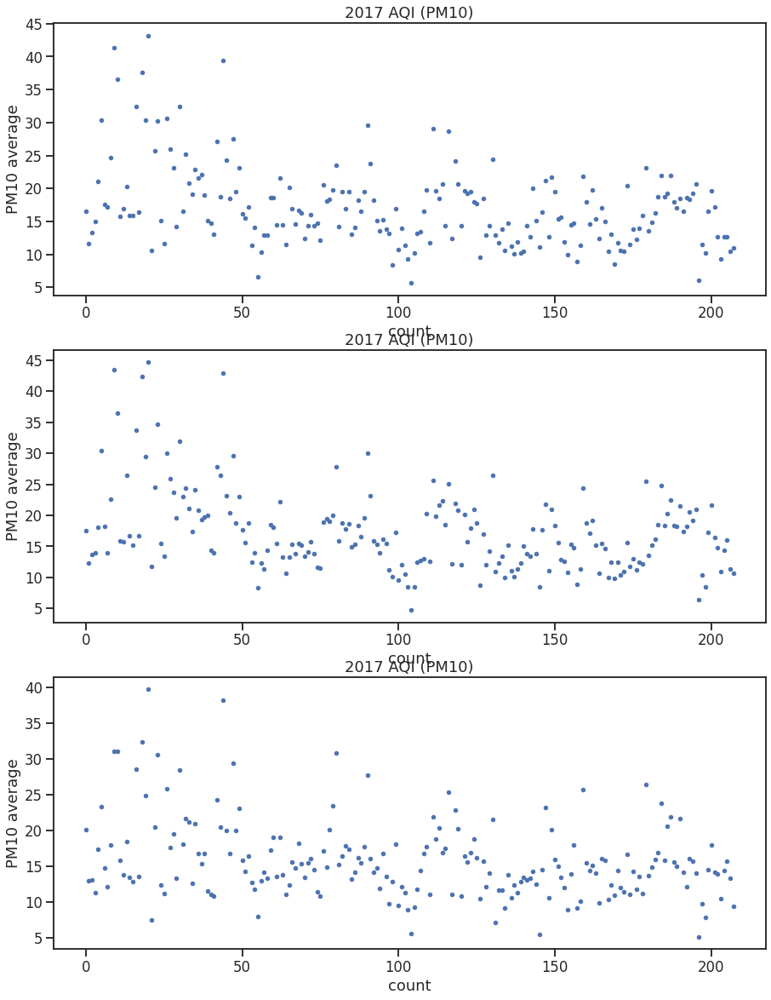

In [6]:
plt.subplots(figsize=(15,20))
plt.subplot(311)
plt.plot(df_2017['AQI_2017'], marker='.', linestyle='none')
plt.title('2017 AQI (PM10)')
plt.xlabel('count')
plt.ylabel('PM10 average')
plt.subplot(312)
plt.plot(df_2018['AQI_2018'], marker='.', linestyle='none')
plt.title('2017 AQI (PM10)')
plt.xlabel('count')
plt.ylabel('PM10 average')
plt.subplot(313)
plt.plot(df_2019['AQI_2019'], marker='.', linestyle='none')
plt.title('2017 AQI (PM10)')
plt.xlabel('count')
plt.ylabel('PM10 average')

Check the spread of pm10 pollutant for all 3 years and it appears to
be about the same for the 3 years but some shifts and changes.
Min appears to be 5 and max appears to be 45 in 2017-2018 but is less and is 40 in 2019

In [7]:
df_2017.info()
df_2018.info()
df_2019.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Columns: 191 entries, GeoFIPS to HNAC_FEMALE_ratio_2017
dtypes: float64(110), int64(79), object(2)
memory usage: 310.5+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Columns: 191 entries, GeoFIPS to HNAC_FEMALE_ratio_2018
dtypes: float64(110), int64(79), object(2)
memory usage: 310.5+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Columns: 191 entries, GeoFIPS to HNAC_FEMALE_ratio_2019
dtypes: float64(110), int64(79), object(2)
memory usage: 310.5+ KB


* basically check ot see that dtypes are numeric types except for 2 object types which are
the state and county name


In [8]:
df_2017.describe()

,GeoFIPS,AQI_2017,Civilian_labor_force_2017,Employed_2017,Unemployed_2017,Unemployment_rate_2017,"Poverty Estimate, All Ages_2017",90% CI LB All Ages_2017,90% CI UB All Ages_2017,"Poverty Percent, All Ages_2017",...,HWAC_MALE_ratio_2017,HWAC_FEMALE_ratio_2017,HBAC_MALE_ratio_2017,HBAC_FEMALE_ratio_2017,HIAC_MALE_ratio_2017,HIAC_FEMALE_ratio_2017,HAAC_MALE_ratio_2017,HAAC_FEMALE_ratio_2017,HNAC_MALE_ratio_2017,HNAC_FEMALE_ratio_2017
count,208.000000,208.000000,2.080000e+02,2.080000e+02,208.000000,208.000000,2.080000e+02,2.080000e+02,2.080000e+02,208.000000,...,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000,208.000000
mean,25399.293269,17.169368,3.371127e+05,3.220508e+05,15061.932692,4.662019,9.463741e+04,8.796484e+04,1.013100e+05,14.147596,...,8.495143,8.319081,0.524275,0.542448,0.472038,0.449677,0.170333,0.170317,0.061210,0.059219
std,16356.273021,6.224215,4.988840e+05,4.758767e+05,23473.087619,1.998151,1.485223e+05,1.438191e+05,1.532598e+05,4.720476,...,8.776509,8.921173,0.683293,0.772676,0.440838,0.422626,0.227773,0.230824,0.126368,0.124525
min,1073.000000,5.642857,2.036100e+04,1.827400e+04,1070.000000,2.100000,6.522000e+03,4.983000e+03,7.652000e+03,4.200000,...,0.547043,0.345578,0.039326,0.034950,0.024999,0.019117,0.007353,0.005822,0.001508,0.000000
25%,8095.000000,12.949097,9.065425e+04,8.596350e+04,4011.500000,3.500000,2.188450e+04,1.912700e+04,2.480000e+04,11.000000,...,2.540512,2.248875,0.179087,0.161033,0.138639,0.130799,0.045521,0.045074,0.020696,0.019053
50%,24524.000000,16.206236,1.889810e+05,1.819240e+05,8531.000000,4.300000,4.890750e+04,4.347250e+04,5.352050e+04,14.100000,...,4.985090,4.869806,0.361718,0.354255,0.311571,0.306226,0.096957,0.096125,0.039338,0.036162
75%,39102.500000,19.630036,3.970120e+05,3.811410e+05,17854.500000,5.125000,1.042855e+05,9.564650e+04,1.122708e+05,16.200000,...,11.551861,11.168294,0.625620,0.646973,0.668222,0.630802,0.190205,0.186325,0.076604,0.072031
max,56025.000000,43.208594,5.084014e+06,4.841864e+06,242150.000000,19.500000,1.490853e+06,1.454153e+06,1.527553e+06,33.100000,...,45.994936,48.370608,7.646195,8.850811,2.010642,1.930860,2.227904,2.263490,1.759816,1.725346


In [9]:
max = df_2017['AQI_2017'].max()
display(df_2017.loc[df_2017['AQI_2017'] == max])

max = df_2018['AQI_2018'].max()
display(df_2018.loc[df_2018['AQI_2018'] == max])

max = df_2019['AQI_2019'].max()
display(df_2019.loc[df_2019['AQI_2019'] == max])

,GeoFIPS,State Name,County Name,AQI_2017,Civilian_labor_force_2017,Employed_2017,Unemployed_2017,Unemployment_rate_2017,"Poverty Estimate, All Ages_2017",90% CI LB All Ages_2017,...,HWAC_MALE_ratio_2017,HWAC_FEMALE_ratio_2017,HBAC_MALE_ratio_2017,HBAC_FEMALE_ratio_2017,HIAC_MALE_ratio_2017,HIAC_FEMALE_ratio_2017,HAAC_MALE_ratio_2017,HAAC_FEMALE_ratio_2017,HNAC_MALE_ratio_2017,HNAC_FEMALE_ratio_2017
20,6031,California,Kings,43.208594,57315,52216,5099,8.9,24810.0,21366.0,...,27.260883,23.155714,0.814486,0.722948,1.576187,1.385762,0.585307,0.452344,0.1343,0.138309


,GeoFIPS,State Name,County Name,AQI_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,"Poverty Estimate, All Ages_2018",90% CI LB All Ages_2018,...,HWAC_MALE_ratio_2018,HWAC_FEMALE_ratio_2018,HBAC_MALE_ratio_2018,HBAC_FEMALE_ratio_2018,HIAC_MALE_ratio_2018,HIAC_FEMALE_ratio_2018,HAAC_MALE_ratio_2018,HAAC_FEMALE_ratio_2018,HNAC_MALE_ratio_2018,HNAC_FEMALE_ratio_2018
20,6031,California,Kings,44.670932,57568,53018,4550,7.9,25481.0,21602.0,...,27.424,23.264985,0.829689,0.722675,1.617762,1.414963,0.602449,0.458443,0.149952,0.149291


,GeoFIPS,State Name,County Name,AQI_2019,Civilian_labor_force_2019,Employed_2019,Unemployed_2019,Unemployment_rate_2019,"Poverty Estimate, All Ages_2019",90% CI LB All Ages_2019,...,HWAC_MALE_ratio_2019,HWAC_FEMALE_ratio_2019,HBAC_MALE_ratio_2019,HBAC_FEMALE_ratio_2019,HIAC_MALE_ratio_2019,HIAC_FEMALE_ratio_2019,HAAC_MALE_ratio_2019,HAAC_FEMALE_ratio_2019,HNAC_MALE_ratio_2019,HNAC_FEMALE_ratio_2019
20,6031,California,Kings,39.722575,57788,53222,4566,7.9,21840.0,18284.0,...,27.601674,23.287564,0.868314,0.734929,1.635282,1.408395,0.62312,0.453119,0.146463,0.137309


In [10]:
min = df_2017['AQI_2017'].min()
display(df_2017.loc[df_2017['AQI_2017'] == min])

min = df_2018['AQI_2018'].min()
display(df_2018.loc[df_2018['AQI_2018'] == min])

min = df_2019['AQI_2019'].min()
display(df_2019.loc[df_2019['AQI_2019'] == min])

,GeoFIPS,State Name,County Name,AQI_2017,Civilian_labor_force_2017,Employed_2017,Unemployed_2017,Unemployment_rate_2017,"Poverty Estimate, All Ages_2017",90% CI LB All Ages_2017,...,HWAC_MALE_ratio_2017,HWAC_FEMALE_ratio_2017,HBAC_MALE_ratio_2017,HBAC_FEMALE_ratio_2017,HIAC_MALE_ratio_2017,HIAC_FEMALE_ratio_2017,HAAC_MALE_ratio_2017,HAAC_FEMALE_ratio_2017,HNAC_MALE_ratio_2017,HNAC_FEMALE_ratio_2017
104,25015,Massachusetts,Hampshire,5.642857,89070,85984,3086,3.5,14206.0,11754.0,...,2.271584,2.572062,0.360076,0.376838,0.124164,0.125406,0.077603,0.086294,0.035387,0.03042


,GeoFIPS,State Name,County Name,AQI_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,"Poverty Estimate, All Ages_2018",90% CI LB All Ages_2018,...,HWAC_MALE_ratio_2018,HWAC_FEMALE_ratio_2018,HBAC_MALE_ratio_2018,HBAC_FEMALE_ratio_2018,HIAC_MALE_ratio_2018,HIAC_FEMALE_ratio_2018,HAAC_MALE_ratio_2018,HAAC_FEMALE_ratio_2018,HNAC_MALE_ratio_2018,HNAC_FEMALE_ratio_2018
104,25015,Massachusetts,Hampshire,4.764706,90562,87804,2758,3.0,15397.0,12778.0,...,2.289948,2.637474,0.371108,0.392829,0.129702,0.124737,0.07447,0.087502,0.034753,0.029167


,GeoFIPS,State Name,County Name,AQI_2019,Civilian_labor_force_2019,Employed_2019,Unemployed_2019,Unemployment_rate_2019,"Poverty Estimate, All Ages_2019",90% CI LB All Ages_2019,...,HWAC_MALE_ratio_2019,HWAC_FEMALE_ratio_2019,HBAC_MALE_ratio_2019,HBAC_FEMALE_ratio_2019,HIAC_MALE_ratio_2019,HIAC_FEMALE_ratio_2019,HAAC_MALE_ratio_2019,HAAC_FEMALE_ratio_2019,HNAC_MALE_ratio_2019,HNAC_FEMALE_ratio_2019
196,50007,Vermont,Chittenden,5.140351,96435,94707,1728,1.8,16084.0,14294.0,...,1.061219,1.138154,0.120288,0.125172,0.066555,0.088537,0.026866,0.039078,0.007938,0.007938


* California Kings county has highest pm10 average levels which is not surprising because california has highest pollution levels
* it appears that it is (43, 44, 39) aqi throughout the years

* Massachusetts, Hampshire county has lowest average pm10 average levels (5.6, 4.7, 5.61 throughout the 3 years

### Perform a hypothesis test on data
* Testing whether the top correlated attribute HWAC_MALE_ratio has an impact on pm10 lvels of a county for year 2017
* HO = on average, counties that have above average hwac ratio will have about the same pm10 aqi as other counties with below ratios
* HA = on average, counties with below or above average hwac ratios will have significantly different levels of pm10 aqi

In [11]:
df_2017.head()
avg_hwac = round(df_2017['HWAC_MALE_ratio_2017'].mean(), 3)
avg_aqi = round(df_2017['AQI_2017'].mean(), 3)
avg_hwac

above_avg_hwac = df_2017.loc[df_2017['HWAC_MALE_ratio_2017'] > avg_hwac].AQI_2017
below_avg_hwac = df_2017.loc[df_2017['HWAC_MALE_ratio_2017'] < avg_hwac].AQI_2017

In [12]:
# two groups variances are not equal
func_t, func_p = stats.ttest_ind(above_avg_hwac, below_avg_hwac, equal_var=False)
print(func_t, func_p)

5.344351656283399 6.201321040496359e-07


With a p of 6e-07 we reject the null hypothesis and assume that on average there is
a significant impact on county pm10 aqi levels when the ratio of HWAC individuals is
above average, which is above 8.50% in our situation.


## Explore relationships (data visualization)

### explore 2017 dataset

In [13]:
# right here using corr() to find r values of dataset on AQI feature
# make a list a that contains r values features greater than 0.4 and less than -0.3
# Use that list to retain a dataframe with those attributes to explore; rather than exploring all unnecessary columns
corr_2017 = list(zip(df_2017.corr()['AQI_2017'].sort_values(ascending=False).index.tolist(), df_2017.corr()['AQI_2017'].sort_values(ascending=False).values.tolist()))
r_feat_2017 = [feature[0] for feature in corr_2017 if feature[1] >= 0.4 or feature[1] <= -0.3]
top_r_features_2017 = df_2017[r_feat_2017]
top_r_features_2017

,AQI_2017,HWAC_MALE_ratio_2017,HWA_MALE_ratio_2017,H_MALE_ratio_2017,HWAC_FEMALE_ratio_2017,HWA_FEMALE_ratio_2017,H_FEMALE_ratio_2017,HIA_MALE_ratio_2017,HIAC_MALE_ratio_2017,HIA_FEMALE_ratio_2017,...,Unemployment_rate_2017,EDU_TOT_ratio_2017,NHWA_MALE_ratio_2017,NHWAC_MALE_ratio_2017,GeoFIPS,NHWA_FEMALE_ratio_2017,NHWAC_FEMALE_ratio_2017,TOT_FEMALE_ratio_2017,NH_MALE_ratio_2017,NH_FEMALE_ratio_2017
0,16.502154,1.840361,1.809433,2.062920,1.588996,1.557916,1.792301,0.043056,0.056701,0.030018,...,4.3,67.978161,24.103129,24.596308,1073,25.841458,26.375116,52.718697,45.218383,50.926396
1,11.672996,2.238765,2.163301,2.559141,2.037251,1.966486,2.363985,0.062472,0.106147,0.052244,...,3.9,68.576580,32.143232,33.176508,1089,32.614537,33.722447,51.156561,46.284297,48.792576
2,13.368852,1.503971,1.430929,1.857743,1.327965,1.247002,1.672937,0.056762,0.097683,0.068642,...,4.3,66.421644,16.498361,16.960817,1101,17.371351,17.894528,52.843597,45.298660,51.170660
3,15.027397,2.369138,2.253127,3.309805,1.990356,1.898106,3.003704,0.891746,0.970019,0.937871,...,10.2,62.246180,9.236145,9.795234,4001,8.948214,9.451394,50.642253,46.047942,47.638549
4,21.075314,16.694163,16.347386,17.753716,16.883169,16.497149,17.846617,0.481324,0.714377,0.442882,...,5.5,69.584629,28.161039,29.203774,4003,26.953325,27.971233,49.314454,32.931830,31.467837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,9.319249,2.548315,2.501568,2.698820,1.998746,1.951998,2.103643,0.063850,0.094635,0.030785,...,2.9,72.311075,46.113677,46.597115,55027,43.734109,44.167379,47.144405,50.156776,45.040762
204,12.681905,6.869809,6.657637,7.621041,6.574073,6.350850,7.337093,0.201016,0.310049,0.197859,...,4.0,66.254904,25.099666,26.054651,55079,26.299975,27.338629,51.586660,40.792299,44.249567
205,12.710843,2.266406,2.201053,2.384142,2.199307,2.127718,2.324276,0.043901,0.074832,0.042155,...,2.9,70.585666,43.443361,44.059227,55133,45.117598,45.736208,50.834749,46.781109,48.510473
206,10.420240,7.126666,6.848145,7.665410,6.550312,6.294154,7.068725,0.279537,0.433028,0.280553,...,3.6,68.593570,39.563109,40.678207,56021,39.153461,40.184189,49.223904,43.110686,42.155179


In [14]:
top_r_features_2017.corr()['AQI_2017']

AQI_2017                   1.000000
HWAC_MALE_ratio_2017       0.561756
HWA_MALE_ratio_2017        0.561563
H_MALE_ratio_2017          0.552829
HWAC_FEMALE_ratio_2017     0.535768
HWA_FEMALE_ratio_2017      0.535365
H_FEMALE_ratio_2017        0.525979
HIA_MALE_ratio_2017        0.506966
HIAC_MALE_ratio_2017       0.505687
HIA_FEMALE_ratio_2017      0.503467
HIAC_FEMALE_ratio_2017     0.499214
HAA_MALE_ratio_2017        0.459683
LESS_HS_TOT_ratio_2017     0.456038
HAA_FEMALE_ratio_2017      0.441761
Unemployment_rate_2017     0.429663
EDU_TOT_ratio_2017        -0.333440
NHWA_MALE_ratio_2017      -0.335116
NHWAC_MALE_ratio_2017     -0.335135
GeoFIPS                   -0.350214
NHWA_FEMALE_ratio_2017    -0.352906
NHWAC_FEMALE_ratio_2017   -0.353483
TOT_FEMALE_ratio_2017     -0.396427
NH_MALE_ratio_2017        -0.518534
NH_FEMALE_ratio_2017      -0.554378
Name: AQI_2017, dtype: float64

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

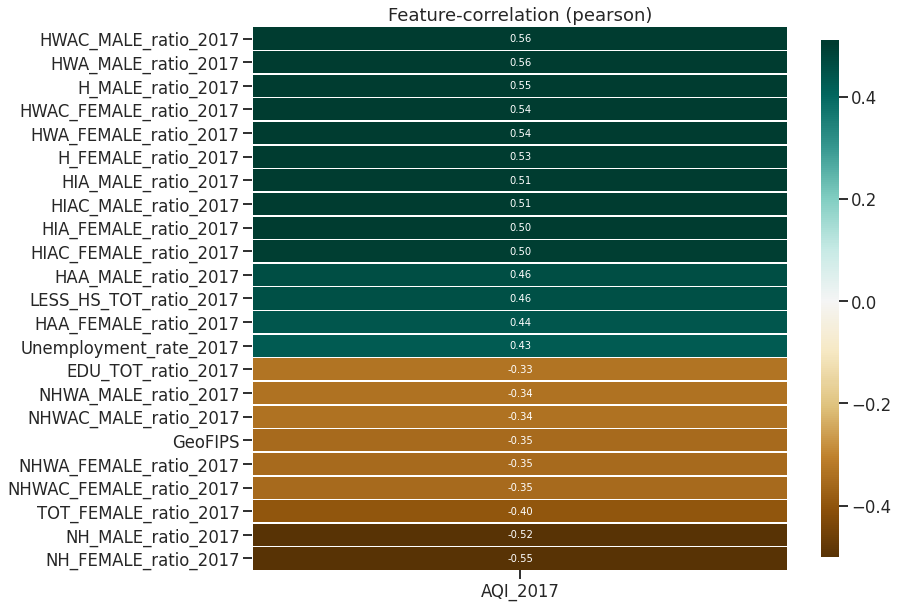

In [15]:
klib.corr_plot(top_r_features_2017, target='AQI_2017', method='pearson')

* This is just a visual for top features in 2017 dataset when looking at our target feature AQI_2017


Note: The number of non binary numerical features is very large (24), please consider splitting the data. Showing plots for the first 20 numerical features. Override this by setting showall=True.


<AxesSubplot:xlabel='NHWA_FEMALE_ratio_2017', ylabel='Density'>

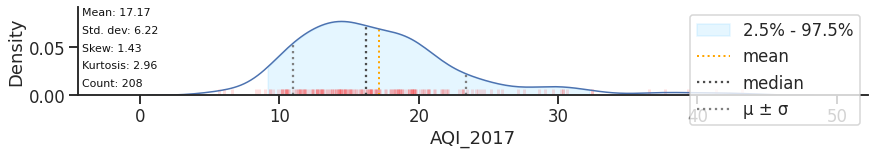

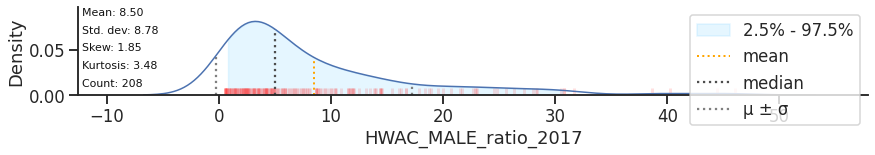

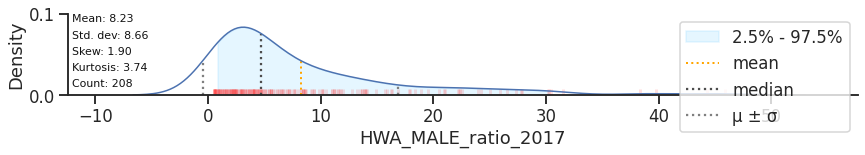

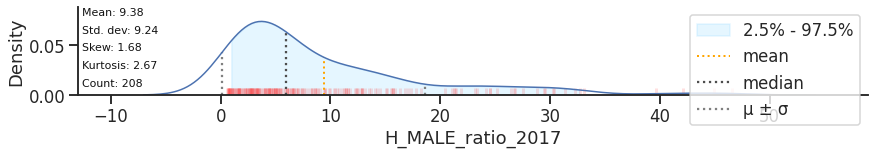

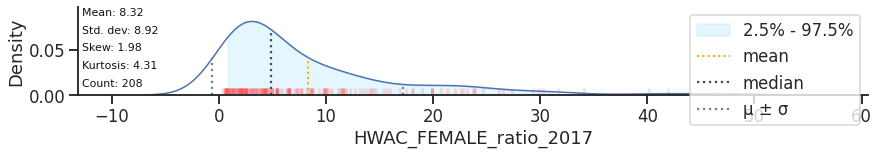

...

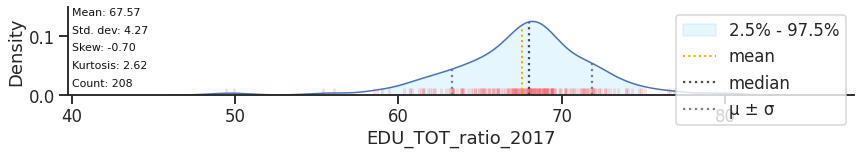

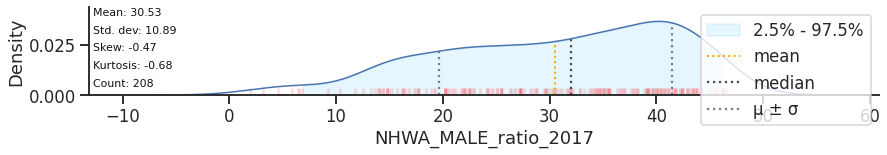

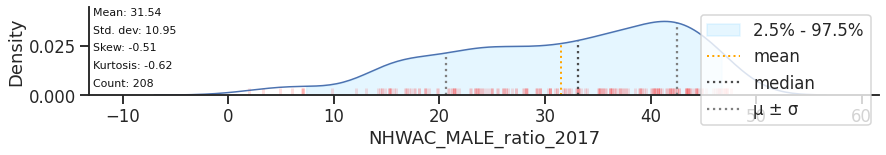

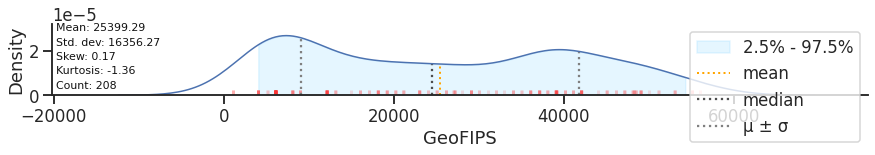

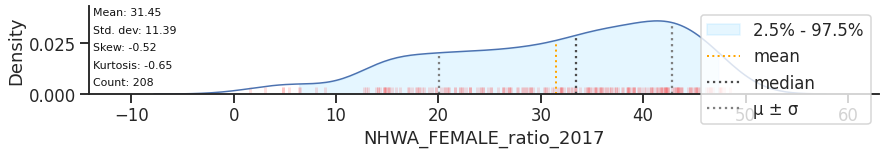

In [16]:
klib.dist_plot(top_r_features_2017)

* To show distribution plots and list descriptive statistics of the top features in 2017 dataset
* also use to notice that most of the features have a right skewed dataset
* only feature to appear normal appeasrs to educaction total population
* Interstingly the top negative covariant features have a left skewed


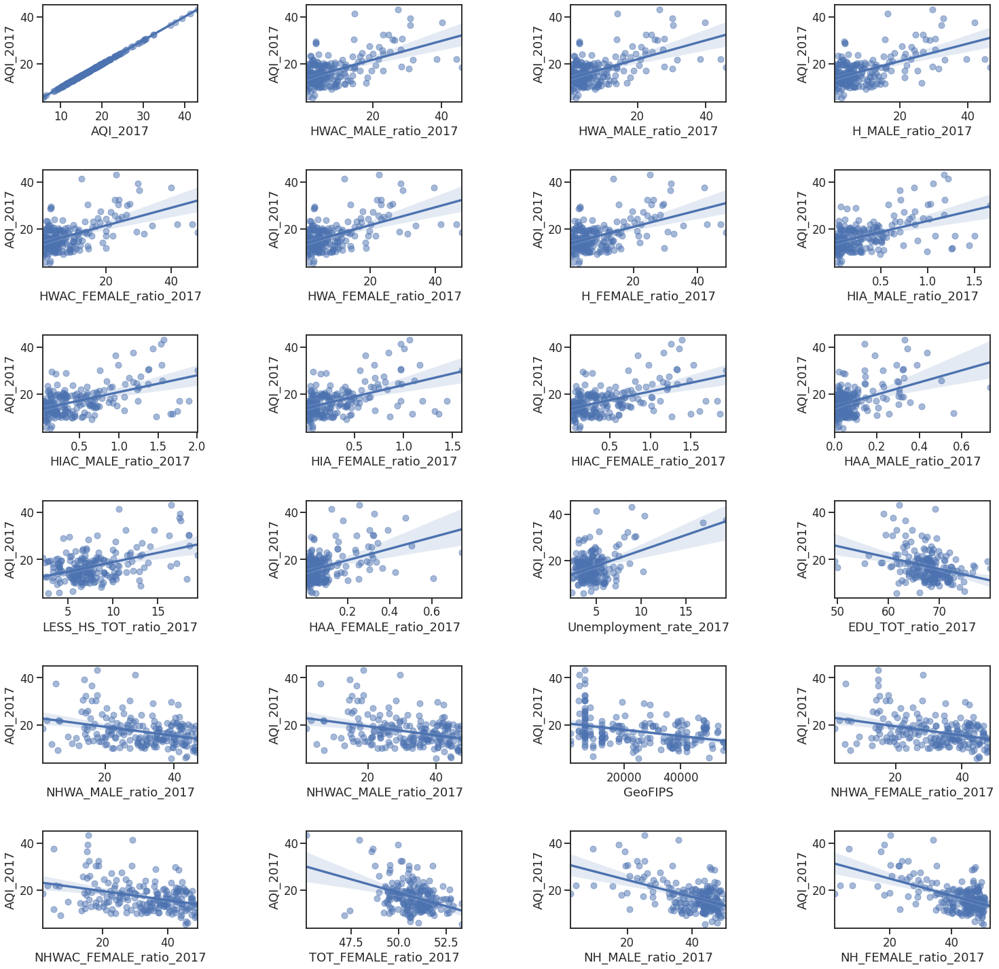

In [17]:
#scatterplots of the top r value features on the target feature are observed for 2017 data
scatterplots(df_2017, 'AQI_2017', r_feat_2017, ncol=4, figsize=(25, 25))


* can see some clustering and some moderate covariance from the scatterplots
* data that have less covariance such as unemployment and  HAA ratio are more scattered and less of a strong relation

In [18]:
# Curious to check distribution of PM10 aqi throughout the us
fips = df_2017['GeoFIPS'].tolist()
values = df_2017['AQI_2017'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2017 avg AQI (PM10) per county')

fig.layout.template = None
fig.show()


Also used to depict range of counties captured from dataset
It appears that we have more small counties in eastern US rather than western US whihc have less counties collected
but the size of the counties are larger.

Also notice that most of the east coast have relatively low pm10 averages (5-14). Whereas mid east contains slightly
more higher pm10 levels.

It appears as wwe approach more west we reach larger pm10 pollution levels; California alone contains counties with
largest traces of pm10. Unfortunately this graph does not show HI.


In [19]:
# Seeing spread of map of top covariance factor HWAC_MALE_ratio
values = df_2017['HWAC_MALE_ratio_2017'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2017 HWAC_MALE_ratio (PM10) per county')

fig.layout.template = None
fig.show()


Following the pattern, it appears that demographics that are abundant in Southern California counties
and sparse in east coast of the US, will be strongly correlated to the PM10 levels.

From the two maps it can be seen that there is strong/moderate correlation as more HWAC ratios are prevalent in
southern California and somewhat sparse in east coast.

This points race being correlated to pattern of pm10 levels

In [20]:
# one of the less moderate features but interesting to look at
values = df_2017['Unemployment_rate_2017'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2017 Unemployment rate per county')

fig.layout.template = None
fig.show()



It appears that unemployment rate has low variety and seems to be relatively low in the US;
there does appear to be some higher values in areas of California but not drastically
greater than other counties in the US
It also appears that unemployment is lowest in east central US; this is relatable to
pm10 concentrations being lower in east coast and central us

In [21]:
# Observing plotting Not hispanic female ratio which has highest negative r, -0.554378
values = df_2017['NH_FEMALE_ratio_2017'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2017 Non-Hispanic Female Ratio per county')

fig.layout.template = None
fig.show()

It appears that there are largely few NH females in California counties and moderate demographic of NH females
dispersed in majority of the US, being more prevalent in the central and eastern coasts of US.

Surprise to see such low number of NH females in respect to the county population in California.
Also appears that main proportion of NH females seens in NE states which is the opposite intensity for pm10 pollutant.

### Repeat data visualization for 2018 data


In [22]:
# Generate a dataset with top r features for 2018 dataset

corr_2018 = list(zip(df_2018.corr()['AQI_2018'].sort_values(ascending=False).index.tolist(), df_2018.corr()['AQI_2018'].sort_values(ascending=False).values.tolist()))
r_feat_2018 = [feature[0] for feature in corr_2018 if feature[1] >= 0.4 or feature[1] <= -0.3]
top_r_features_2018 = df_2018[r_feat_2018]
top_r_features_2018

,AQI_2018,HWAC_MALE_ratio_2018,HWA_MALE_ratio_2018,H_MALE_ratio_2018,HWAC_FEMALE_ratio_2018,HWA_FEMALE_ratio_2018,H_FEMALE_ratio_2018,HIAC_MALE_ratio_2018,HIA_MALE_ratio_2018,HIAC_FEMALE_ratio_2018,...,GRAD_TOT_ratio_2018,NHWAC_MALE_ratio_2018,NHWA_MALE_ratio_2018,GeoFIPS,EDU_TOT_ratio_2018,NHWAC_FEMALE_ratio_2018,NHWA_FEMALE_ratio_2018,TOT_FEMALE_ratio_2018,NH_MALE_ratio_2018,NH_FEMALE_ratio_2018
0,17.511019,1.881780,1.851754,2.110007,1.642027,1.608513,1.858274,0.057474,0.044432,0.049588,...,8.600334,24.499529,23.995912,1073,68.545882,26.299723,25.754099,52.738506,45.151487,50.880231
1,12.362288,2.302427,2.226134,2.615230,2.110876,2.036490,2.449292,0.104359,0.064577,0.095639,...,11.446064,33.123072,32.063683,1089,68.938309,33.633693,32.506185,51.151214,46.233556,48.701922
2,13.661017,1.520503,1.445449,1.872815,1.358916,1.271059,1.699308,0.101543,0.058719,0.109932,...,9.341655,16.673878,16.208544,1101,67.033128,17.588652,17.068573,52.878978,45.248208,51.179670
3,13.913165,2.368571,2.259832,3.372322,2.018653,1.923854,3.099079,1.016297,0.941016,1.076243,...,3.124565,9.714071,9.155038,4001,62.799020,9.479862,8.957076,50.810668,45.817011,47.711589
4,18.148405,16.642539,16.309498,17.693872,16.876696,16.486698,17.852877,0.704053,0.480971,0.689022,...,6.133943,29.234798,28.177928,4003,69.865110,27.859126,26.795928,49.276566,33.029562,31.423689
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,10.886525,2.628852,2.578757,2.781415,2.048205,1.995833,2.159780,0.088805,0.061480,0.069450,...,3.255660,46.524655,46.031674,55027,73.340012,44.049503,43.603202,47.131488,50.087097,44.971708
204,14.358757,7.050284,6.833803,7.815673,6.776885,6.546782,7.553046,0.316695,0.205075,0.320602,...,7.803620,25.871280,24.896063,55079,66.442558,27.098986,26.054285,51.569164,40.615163,44.016119
205,16.010363,2.295775,2.229195,2.421731,2.248573,2.173049,2.379000,0.077760,0.046706,0.080741,...,11.372162,43.948405,43.310676,55133,70.585900,45.597756,44.960027,50.816104,46.762165,48.437104
206,11.341549,7.079351,6.788044,7.627573,6.603955,6.362211,7.134982,0.419764,0.255905,0.412684,...,6.009538,40.708036,39.576190,56021,68.720700,40.206342,39.148334,49.265160,43.107267,42.130178


In [23]:
top_r_features_2018.corr()['AQI_2018']

AQI_2018                   1.000000
HWAC_MALE_ratio_2018       0.582798
HWA_MALE_ratio_2018        0.582433
H_MALE_ratio_2018          0.573159
HWAC_FEMALE_ratio_2018     0.558430
HWA_FEMALE_ratio_2018      0.557753
H_FEMALE_ratio_2018        0.547916
HIAC_MALE_ratio_2018       0.526081
HIA_MALE_ratio_2018        0.522697
HIAC_FEMALE_ratio_2018     0.521759
HIA_FEMALE_ratio_2018      0.519462
HAA_MALE_ratio_2018        0.484867
LESS_HS_TOT_ratio_2018     0.472371
HAA_FEMALE_ratio_2018      0.466142
Unemployment_rate_2018     0.462862
GRAD_TOT_ratio_2018       -0.301252
NHWAC_MALE_ratio_2018     -0.344799
NHWA_MALE_ratio_2018      -0.345958
GeoFIPS                   -0.348185
EDU_TOT_ratio_2018        -0.354234
NHWAC_FEMALE_ratio_2018   -0.359591
NHWA_FEMALE_ratio_2018    -0.360279
TOT_FEMALE_ratio_2018     -0.377488
NH_MALE_ratio_2018        -0.542114
NH_FEMALE_ratio_2018      -0.573108
Name: AQI_2018, dtype: float64

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

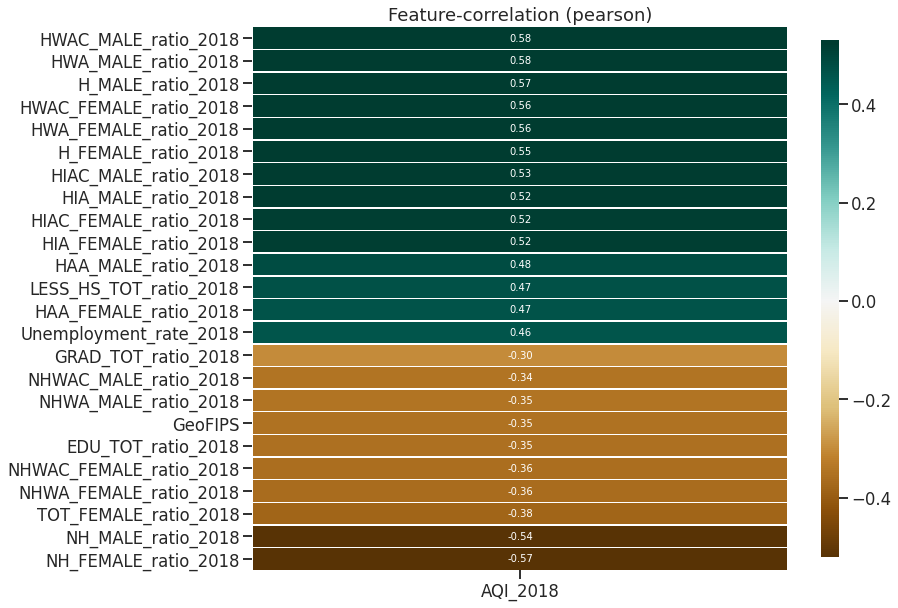

In [24]:
# Produce colored visual of top correlated features
klib.corr_plot(top_r_features_2018, target='AQI_2018', method='pearson')

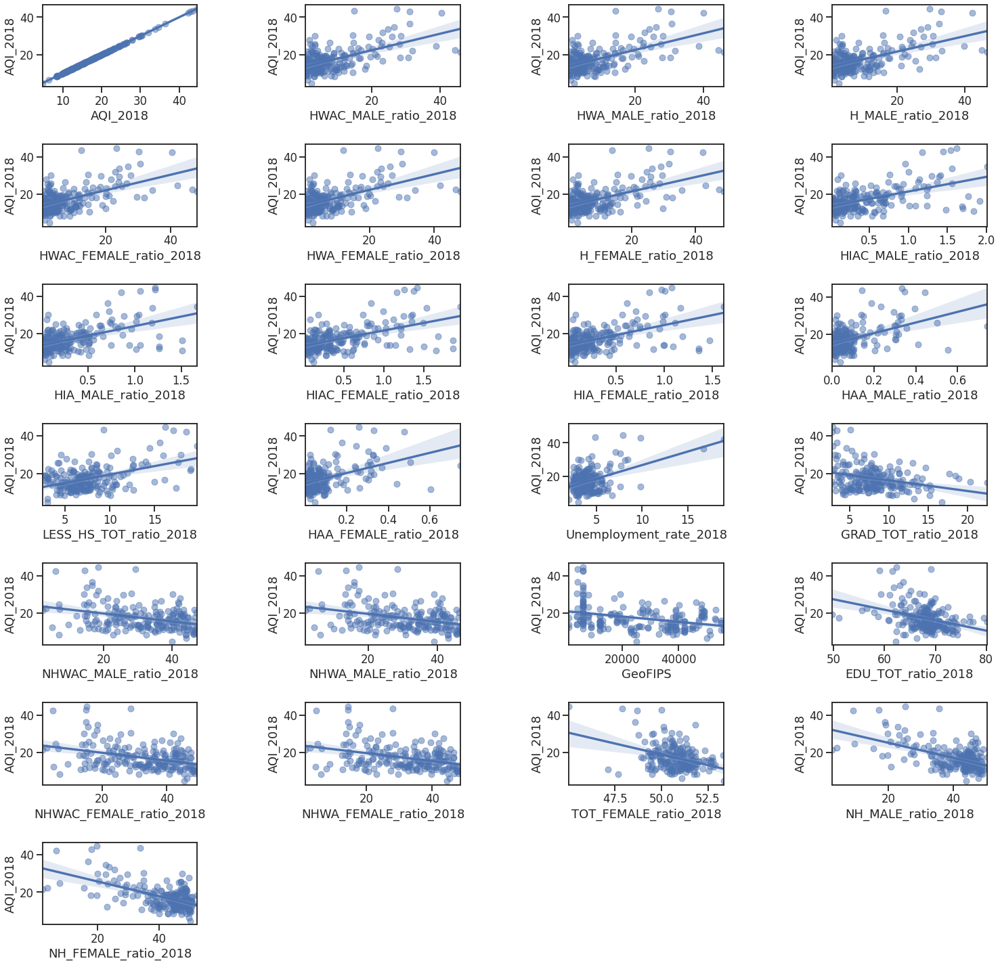

In [25]:
#scatterplots of the top r value features on the target feature are observed for 2018 data
scatterplots(df_2018, 'AQI_2018', r_feat_2018, ncol=4, figsize=(25, 25))

In [26]:
# Observe calculated average pm10 aqi throughout captured counties
fips = df_2018['GeoFIPS'].tolist()
values = df_2018['AQI_2018'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2018 avg AQI (PM10) per county')

fig.layout.template = None
fig.show()

* relatively same results/metrics as 2017 data

In [27]:
#LESS_HS_TOT_ratio_2018
# Seeing spread of map of top covariance factor HWAC_MALE_ratio
values = df_2018['HWAC_MALE_ratio_2018'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2018 HWAC_MALE_ratio per county')

fig.layout.template = None
fig.show()

In [28]:
# Seeing spread of map of top covariance factor LESS_HS_TOT_ratio_2018
values = df_2018['LESS_HS_TOT_ratio_2018'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2018 Less than HighSchool graduate ratio per county')

fig.layout.template = None
fig.show()

The pm10 levels are moderate in central states; whereas it is shown that hwac male ratios are small thoughout northern and eastern states
Besides this observation, it appears that the two features are moderate-strongly correlated as suggested by plots


In [29]:
# Observing plotting Not hispanic female ratio which has highest negative r, -0.57
values = df_2018['NH_FEMALE_ratio_2018'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2018 Non-Hispanic Female Ratio per county')

fig.layout.template = None
fig.show()


* It appears that the lack of ratio for NH females per county is much more drastic in California 2018 data than in 2017 data where it only
appeared that southern california counties were low, in 2018 it appears that all of California has low ratio NH females; also it appears there is
an increase of ratio for NH females in NE states than observed in 2017 data


## Explore 2019 data

In [30]:
# Generate a dataset with top r features for 2019 dataset

corr_2019 = list(zip(df_2019.corr()['AQI_2019'].sort_values(ascending=False).index.tolist(), df_2019.corr()['AQI_2019'].sort_values(ascending=False).values.tolist()))
r_feat_2019 = [feature[0] for feature in corr_2019 if feature[1] >= 0.4 or feature[1] <= -0.3]
top_r_features_2019 = df_2019[r_feat_2019]
top_r_features_2019


,AQI_2019,HWA_MALE_ratio_2019,HWAC_MALE_ratio_2019,H_MALE_ratio_2019,HWA_FEMALE_ratio_2019,HWAC_FEMALE_ratio_2019,H_FEMALE_ratio_2019,LESS_HS_TOT_ratio_2019,Unemployment_rate_2019,HIA_MALE_ratio_2019,EDU_TOT_ratio_2019,NHWA_MALE_ratio_2019,NHWAC_MALE_ratio_2019,NHWA_FEMALE_ratio_2019,NHWAC_FEMALE_ratio_2019,NH_MALE_ratio_2019,NH_FEMALE_ratio_2019
0,20.073389,1.899106,1.931601,2.163314,1.657827,1.694117,1.917175,6.034107,2.9,0.042972,68.605606,23.886950,24.409747,25.627835,26.184645,45.095229,50.824282
1,12.958515,2.275354,2.353121,2.670625,2.093272,2.174257,2.518845,4.895832,2.5,0.061677,68.954088,32.077799,33.161442,32.425069,33.563953,46.232995,48.577535
2,13.125000,1.485302,1.559037,1.917999,1.324144,1.402736,1.766114,6.984096,3.1,0.060931,66.807661,15.905177,16.370107,16.793974,17.323367,45.057973,51.257914
3,11.247911,2.337001,2.469153,3.490200,1.944719,2.046267,3.097918,11.748995,9.9,0.957058,64.344040,9.132388,9.706901,8.861129,9.399474,45.867820,47.544062
4,17.413408,16.440336,16.791347,17.860263,16.514191,16.901733,17.866616,7.980337,5.7,0.493957,70.228395,27.918076,29.019552,26.852337,27.961754,32.771875,31.501247
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,10.503937,2.596796,2.651442,2.806271,2.067419,2.127756,2.242740,7.451132,3.0,0.056922,72.252644,45.975022,46.454308,43.589977,44.024864,49.996015,44.954974
204,14.431990,6.944189,7.161165,7.935491,6.653196,6.882860,7.672730,7.289003,4.0,0.207565,66.702406,24.723017,25.730286,25.900631,26.980648,40.470601,43.921178
205,15.656425,2.271659,2.343406,2.477251,2.214509,2.297884,2.434450,2.518568,2.9,0.052450,71.027566,43.185271,43.863156,44.800568,45.469052,46.726357,48.361941
206,13.354142,6.837186,7.128643,7.665327,6.463317,6.737688,7.252261,3.811055,3.5,0.256281,68.115578,39.485427,40.638191,39.065327,40.155779,43.001005,42.081407


In [31]:
top_r_features_2019.corr()['AQI_2019']

AQI_2019                   1.000000
HWA_MALE_ratio_2019        0.529591
HWAC_MALE_ratio_2019       0.527989
H_MALE_ratio_2019          0.516536
HWA_FEMALE_ratio_2019      0.509798
HWAC_FEMALE_ratio_2019     0.508462
H_FEMALE_ratio_2019        0.496121
LESS_HS_TOT_ratio_2019     0.452503
Unemployment_rate_2019     0.415146
HIA_MALE_ratio_2019        0.402144
EDU_TOT_ratio_2019        -0.306762
NHWA_MALE_ratio_2019      -0.332598
NHWAC_MALE_ratio_2019     -0.334176
NHWA_FEMALE_ratio_2019    -0.341380
NHWAC_FEMALE_ratio_2019   -0.343210
NH_MALE_ratio_2019        -0.496329
NH_FEMALE_ratio_2019      -0.511540
Name: AQI_2019, dtype: float64

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

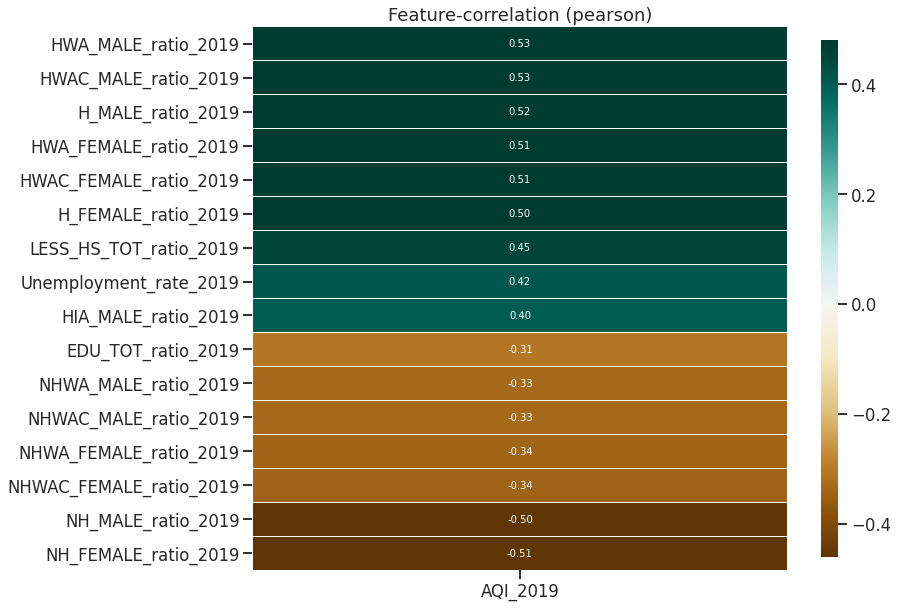

In [32]:
# Produce colored visual of top correlated features
klib.corr_plot(top_r_features_2019, target='AQI_2019', method='pearson')

Although relatively same features as 2017, and 2018; tt appears that 2019 had smallest high r values
with pm10 aqi

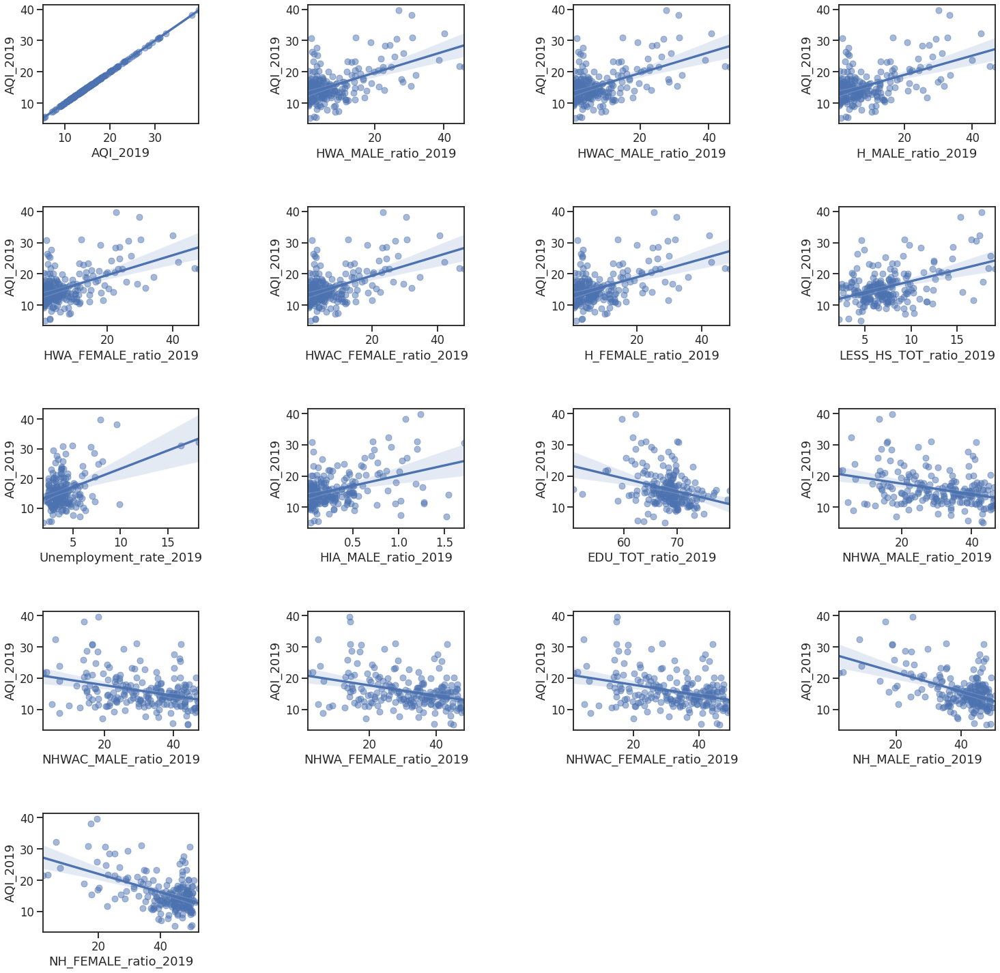

In [33]:
#scatterplots of the top r value features on the target feature are observed for 2019 data
scatterplots(df_2019, 'AQI_2019', r_feat_2019, ncol=4, figsize=(25, 25))

In [34]:
# Observe calculated average pm10 aqi throughout captured counties
fips = df_2019['GeoFIPS'].tolist()
values = df_2019['AQI_2019'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2019 avg AQI (PM10) per county')

fig.layout.template = None
fig.show()

It appears this decrease covariance with other features can be explained by, the aqi being smaller for year 2019 than the other years observed;
whereas the feature data did not change much

In [35]:
#LESS_HS_TOT_ratio_2019
# Seeing spread of map of top covariance factor HWAC_MALE_ratio
values = df_2019['HWAC_MALE_ratio_2019'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2019 HWAC_MALE_ratio per county')

fig.layout.template = None
fig.show()

About the same as 2018 results

In [36]:
# Seeing spread of map of top covariance factor LESS_HS_TOT_ratio_2019
values = df_2019['LESS_HS_TOT_ratio_2019'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2019 Less than HighSchool graduate ratio per county')

fig.layout.template = None
fig.show()


In [37]:
# Observing plotting Not hispanic female ratio which has highest negative r, -0.57
values = df_2019['NH_FEMALE_ratio_2019'].tolist()

fig = ff.create_choropleth(fips=fips, values=values, county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
    legend_title='2019 Non-Hispanic Female Ratio per county')

fig.layout.template = None
fig.show()

The NH female ratio appears to remain the same increase as observed in 2018 result


## Conclusion




In [38]:
# print top r features for comparison
from itertools import zip_longest

r_val_2017 = [round(feature[1],3) for feature in corr_2017 if feature[1] >= 0.4 or feature[1] <= -0.3]
r_val_2018 = [round(feature[1],3) for feature in corr_2018 if feature[1] >= 0.4 or feature[1] <= -0.3]
r_val_2019 = [round(feature[1], 3) for feature in corr_2019 if feature[1] >= 0.4 or feature[1] <= -0.3]

r_feat_val_2017 = list(zip(r_feat_2017, r_val_2017))
r_feat_val_2018 = list(zip(r_feat_2018, r_val_2018))
r_feat_val_2019 = list(zip(r_feat_2019, r_val_2019))

for feature2017, feature2018, feature2019 in zip_longest(r_feat_val_2017, r_feat_val_2018, r_feat_val_2019):
    print('----------------------------------')
    print(feature2017)
    print(feature2018)
    print(feature2019)

# display(top_r_features_2017.corr()['AQI_2017'], top_r_features_2018.corr()['AQI_2018'], top_r_features_2019.corr()['AQI_2019'])
display(top_r_features_2017.shape, top_r_features_2018.shape, top_r_features_2019.shape)

----------------------------------
('AQI_2017', 1.0)
('AQI_2018', 1.0)
('AQI_2019', 1.0)
----------------------------------
('HWAC_MALE_ratio_2017', 0.562)
('HWAC_MALE_ratio_2018', 0.583)
('HWA_MALE_ratio_2019', 0.53)
----------------------------------
('HWA_MALE_ratio_2017', 0.562)
('HWA_MALE_ratio_2018', 0.582)
('HWAC_MALE_ratio_2019', 0.528)
----------------------------------
('H_MALE_ratio_2017', 0.553)
('H_MALE_ratio_2018', 0.573)
('H_MALE_ratio_2019', 0.517)
----------------------------------
('HWAC_FEMALE_ratio_2017', 0.536)
('HWAC_FEMALE_ratio_2018', 0.558)
('HWA_FEMALE_ratio_2019', 0.51)
----------------------------------
('HWA_FEMALE_ratio_2017', 0.535)
('HWA_FEMALE_ratio_2018', 0.558)
('HWAC_FEMALE_ratio_2019', 0.508)
----------------------------------
('H_FEMALE_ratio_2017', 0.526)
('H_FEMALE_ratio_2018', 0.548)
('H_FEMALE_ratio_2019', 0.496)
----------------------------------
('HIA_MALE_ratio_2017', 0.507)
('HIAC_MALE_ratio_2018', 0.526)
('LESS_HS_TOT_ratio_2019', 0.453)
-

(208, 24)

(208, 25)

(208, 17)

Datasets 2017 data yielded 24 columns, 2018 yielded 25 columns, and 2019 yielded 17 columns for
columns where r is greater than .39 or less than -0.29.
From the 3 separate yeared datasets it appears that the common positive r attributes are hispanic demographic features,
unemployment rates, and less-than-highschool-attainment ratios.
Whereas for negative r attributes, they appear to be NH demographic attributes, and education-attainment totals.

